---
title: Visualizing SPI distance as compared to NCBI taxonomic category

author: Benjamin Doran

---

In [1]:
using DrWatson
@quickactivate "Doran_etal_2022"

In [31]:
using Muon
using LinearAlgebra
using Distances
using Statistics
using StatsPlots
using StatsBase
using Random: shuffle
using SPI
using HypothesisTests
using NewickTree, NewickTreeTools
using DataFrames
theme(:default, grid=false, label="")
include(srcdir("helpers.jl"))


"""    
    p_distances(t::Node)

shortest branch length path between all leafs with `t` as ancester

sibling nodes `i`, and `j` of parent `p` would have patristic `distance(i, p) + distance(j, p)`
"""
function p_distances(tree::NewickTree.Node)
    leaves = getleaves(tree) # |> x->sort(x; by=name)
    dists = zeros(length(leaves), length(leaves))
    for j in axes(dists, 2), i in (j+1):lastindex(dists, 1)
        dists[i, j] = NewickTree.getdistance(leaves[i], leaves[j])
        dists[j, i] = dists[i, j]
    end
    return dists
end

p_distances

In [3]:
UP7047_NCOLS = 10177

10177

## Setup

In [4]:
biobank = readh5mu(joinpath(datadir(), "exp_pro", "BB669", "BB669.h5mu"))

┌ Warning: Cannot join columns with the same name because var_names are intersecting.
└ @ Muon /Users/bend/.julia/packages/Muon/eLqpV/src/mudata.jl:351


MuData object 669 ✕ 21485
└ metabolites_foldchange
  AnnData object 669 ✕ 50
└ metabolites_millimolar
  AnnData object 669 ✕ 10
└ UPorder_oggs
  AnnData object 669 ✕ 10177
└ oggs
  AnnData object 669 ✕ 11248

In [5]:
pdir = plotsdir("BB669distanceplots_16S_bac120_taxonomy") |> mkpath

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy"

In [6]:
keys(biobank["UPorder_oggs"].obsp)

KeySet for a Muon.AlignedMapping{Tuple{1 => 1, 2 => 1}, String, AnnData} with 1 entry. Keys:
  "SDij"

In [7]:
SPImtx = biobank["UPorder_oggs"].obsp["SDij"][:, :];

In [8]:
BBusv = svd(biobank["oggs"].X[:, :])
BBSPImtx = calc_spi_mtx(BBusv.U, BBusv.S, getintervals(BBusv.S, alpha=1.5, q=.75)) ./ size(BBusv.V,1);

In [9]:
taxaranklabels = string.([:phylum :class :order :family :genus :species])
taxarankcolors = [:grey :red :pink :orange :lightblue :green :aqua]|> reverse;

In [10]:
uppertriangle = triu(trues(size(SPImtx)), 1);

In [16]:
# 4 Main metabolites  ["Acetate_mM", "Butyrate_mM", "Propionate_mM", "Succinate_mM"]
# metabolitedistance = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, 1:4]');
# metabolitedistancerel = Distances.pairwise(Euclidean(), biobank["metabolites_foldchange"].X[:, :]');
# metabolitedistance_mM = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, :]');

# bbtaxa = biobank.obs[:,[:phylum_gtdb, :class_gtdb, :order_gtdb, :family_gtdb, :genus_gtdb, :species_gtdb]];
bbtaxa = biobank.obs[:,[:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]];

taxanomicdistance = pairwise(eachrow(Matrix(bbtaxa)[:,6:-1:1])) do a, b
    x = findfirst(a .== replace(b, "<unclassified>"=>"missing"))
    x === nothing ? 6 : x-1
end;

## conflated pairs violin plots

In [11]:
# bbtaxa = biobank.obs[:,[:phylum_gtdb, :class_gtdb, :order_gtdb, :family_gtdb, :genus_gtdb, :species_gtdb]];
bbtaxa = biobank.obs[:,[:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]];

In [12]:
# 4 Main metabolites  ["Acetate_mM", "Butyrate_mM", "Propionate_mM", "Succinate_mM"]
# metabolitedistance = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, 1:4]');
# metabolitedistancerel = Distances.pairwise(Euclidean(), biobank["metabolites_foldchange"].X[:, :]');
# metabolitedistance_mM = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, :]');

taxanomicdistance = pairwise(eachrow(Matrix(bbtaxa)[:,6:-1:1])) do a, b
    x = findfirst(a .== replace(b, "<unclassified>"=>"missing"))
    x === nothing ? 6 : x-1
end;

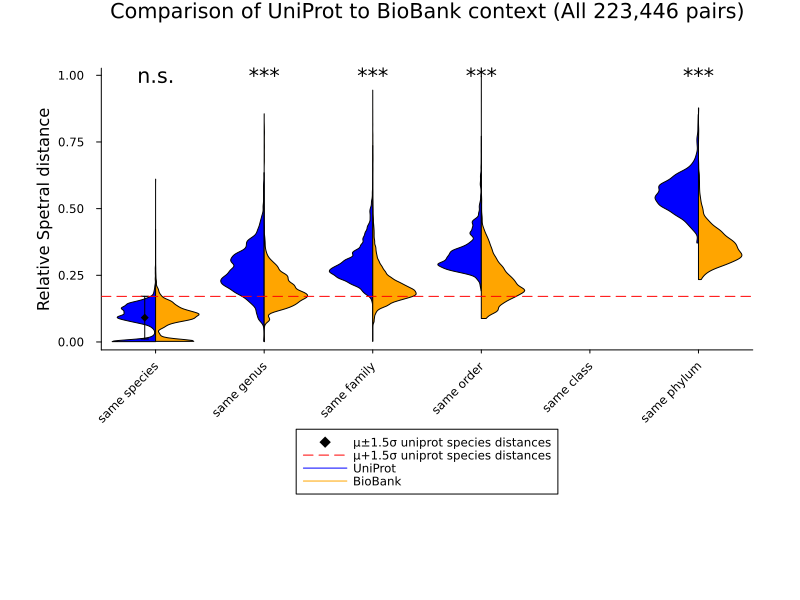

In [13]:
n = 6
labels = ["same species", "same genus", "same family", "same order", "same class", "same phylum", "same kingdom"];
plot(size=(800,600), 
    title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative Spetral distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:n, labels[1:n]),
    xlims=(.5, n +.5),
    xrotation=45,
    legend=:outerbottom,
    grid=false,
)
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in 0:n
    mask = xdata .== i
    violin!(xdata[mask].+1, ydata1[mask],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        )
    violin!(xdata[mask].+1, ydata2[mask],
        label="",
        c=:orange, 
        side=:right,
        trim=true
        )
end
allspeciesdists = ydata1[xdata.==0]
allspeciesdists2 = ydata2[xdata.==0]
scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="μ±1.5σ uniprot species distances", shape=:diamond)
# scatter!([1.1], [mean(allspeciesdists2)], yerror=1.5std(allspeciesdists2), c=:black,  shape=:diamond)
# hline!([mean(allspeciesdists)+std(allspeciesdists)], c=:red, linestyle=:dash)
hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ uniprot species distances", linestyle=:dash)
# hline!([mean(allspeciesdists2)+1.5std(allspeciesdists2)], c=:orange, linestyle=:dash)
plot!([0 0], c=[:blue :orange], label=["UniProt" "BioBank"])
annotate!(1:6, ones(6), ["n.s.", "***", "***", "***", "", "***"], fontsize=5)
plot!()

In [14]:
savefig(joinpath(pdir, "SPIdistUPvsSPIdistBB_splitbyNCBItaxonomy_groupedviolin.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/SPIdistUPvsSPIdistBB_splitbyNCBItaxonomy_groupedviolin.pdf"

## KS and wilcoxon test of each distribution

In [16]:
using HypothesisTests

In [17]:
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in 0:n
    mask = xdata .== i
    pval = pvalue(ApproximateTwoSampleKSTest(ydata1[mask], ydata2[mask]))
    @show (i, pval * 7)
end

(i, pval * 7) = (0, 1.4737693215045304e-24)
(i, pval * 7) = (1, 0.0)
(i, pval * 7) = (2, 0.0)
(i, pval * 7) = (3, 0.0)
(i, pval * 7) = (4, NaN)
(i, pval * 7) = (5, 0.0)
(i, pval * 7) = (6, 0.0)


In [18]:
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in [0, 1, 2, 3, 5, 6]
    mask = xdata .== i
    pval = pvalue(MannWhitneyUTest(ydata1[mask], ydata2[mask]); tail=:right)
    @show (i, pval * 7)
end

(i, pval * 7) = (0, 0.43019467825203483)
(i, pval * 7) = (1, 0.0)
(i, pval * 7) = (2, 0.0)
(i, pval * 7) = (3, 0.0)
(i, pval * 7) = (5, 0.0)
(i, pval * 7) = (6, 0.0)


## 16S tree taxanomic distances

In [57]:
# bbtaxa = biobank.obs[:,[:phylum_gtdb, :class_gtdb, :order_gtdb, :family_gtdb, :genus_gtdb, :species_gtdb]];
bbtaxa = biobank.obs[:,[:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]];
taxanomicdistance = pairwise(eachrow(Matrix(bbtaxa)[:,6:-1:1])) do a, b
    x = findfirst(a .== replace(b, "<unclassified>"=>"missing"))
    x === nothing ? 6 : x-1
end;

In [ ]:
treebac120 = readnw(readline(projectdir("_research","BB669_bac120_phyml","BB669_bac120.phy-supporttree.txt")))
as_polytomy!(n->NewickTree.support(n)<0.5, treebac120)
ladderize!(treebac120)
leafnames_bac120 = getleafnames(treebac120); # same order as returned by patristic_distances
# order_treebac120 = filter(!isnothing, indexin(biobank.obs.ID, leafnames_bac120));
order_treebac120 = indexin(leafnames_bac120, biobank.obs.ID);

spitree = readnw(readline(datadir("exp_pro","BB669","BB669_inferred_spitree_nj.nw")))
as_polytomy!(n->NewickTree.support(n)<0.5, spitree)
ladderize!(spitree)
leafnames_spitree = getleafnames(spitree); # same order as returned by patristic_distances
# order_spi_treebac120 = filter(!isnothing, indexin(leafnames_spitree, leafnames_bac120));
order_spi_treebac120 = indexin(leafnames_bac120, leafnames_spitree);

Pij = p_distances(treebac120);
# Dij = sqrt.(SPImtx .* 10177)[order_treebac120, order_treebac120];
Dij = SPImtx[order_treebac120, order_treebac120];
spiDij = p_distances(spitree)[order_spi_treebac120, order_spi_treebac120];
Tij = taxanomicdistance[order_treebac120, order_treebac120];
uppertriangle = triu(trues(size(Pij)), 1);

In [58]:
tree16s = readnw(readline(projectdir("_research","BB669_16S_phyml","BB669_16S.phy-supporttree.txt")))
as_polytomy!(n->NewickTree.support(n)<0.5, tree16s)
ladderize!(tree16s)
leafnames_16S = getleafnames(tree16s); # same order as returned by patristic_distances
# order_tree16s = filter(!isnothing, indexin(biobank.obs.ID, leafnames_16S));
order_tree16S = indexin(leafnames_16S, biobank.obs.ID);

In [59]:
spitree = readnw(readline(datadir("exp_pro","BB669","BB669_inferred_spitree_nj.nw")))
as_polytomy!(n->NewickTree.support(n)<0.5, spitree)
ladderize!(spitree)
leafnames_spitree = getleafnames(spitree); # same order as returned by patristic_distances
# order_spi_tree16s = filter(!isnothing, indexin(leafnames_spitree, leafnames_16S));
order_spi_tree16s = indexin(leafnames_16S, leafnames_spitree);

In [60]:
Pij = p_distances(tree16s);
# Dij = sqrt.(SPImtx .* 10177)[order_tree16S, order_tree16S];
Dij = SPImtx[order_tree16S, order_tree16S];
spiDij = p_distances(spitree)[order_spi_tree16s, order_spi_tree16s];
Tij = taxanomicdistance[order_tree16S, order_tree16S];
uppertriangle = triu(trues(size(Pij)), 1);

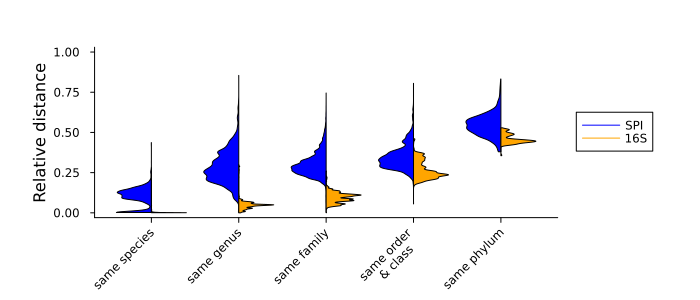

In [61]:
skipidxs = Not(5, 7)
labels = ["same species", "same genus", "same family", "same order\n & class", "same class ", "same phylum", "same kingdom"];
plot(size=(700,300), 
    # title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:(length(labels[skipidxs])), labels[skipidxs]),
    xlims=(.5, length(labels[skipidxs]) +.5),
    xrotation=45,
    ylims=(0,1), widen=true,
    legend=:outerright,
    # legendcolumns=2,
    grid=false,
)
xdata = Tij[uppertriangle]
ydata1 = (spiDij ./ maximum(spiDij))[uppertriangle]
ydata2 = (Pij ./ maximum(Pij))[uppertriangle]
# ydata2 = (spiDij ./ maximum(spiDij))[uppertriangle]
# ydata1 = (Dij)[uppertriangle]
# ydata2 = (Pij)[uppertriangle]
for (x, i) in enumerate(collect(0:6)[skipidxs])
    mask = xdata .== i
    violin!([x], ydata1[mask],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        )
    violin!([x], ydata2[mask],
        label="",
        c=:orange, 
        side=:right,
        trim=true
        )
end
plot!([0 0], c=[:blue :orange], label=["SPI" "16S"])
# allspeciesdists = ydata1[xdata.==0]
# allspeciesdists2 = ydata2[xdata.==0]
# scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="", shape=:diamond)
# hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ", linestyle=:dash)
# annotate!(1:6, ones(6), ["n.s.", "***", "***", "***", "", "***"], fontsize=5)
plot!()

In [45]:
savefig(joinpath(pdir, "SPIdistUPvs16Spatdist_splitbyNCBItaxonomy_groupedviolin.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/SPIdistUPvs16Spatdist_splitbyNCBItaxonomy_groupedviolin.pdf"

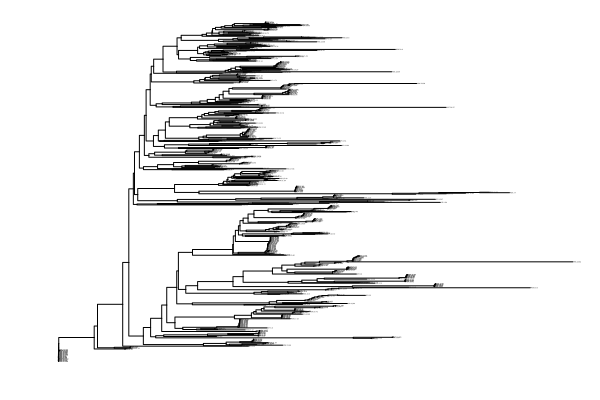

In [22]:
plot(spitree, fs=1, )

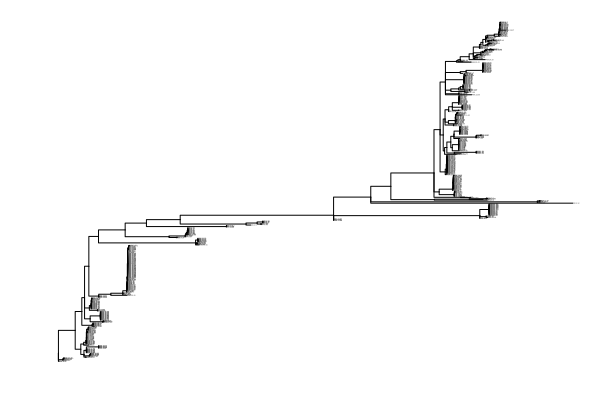

In [23]:
plot(tree16s, fs=1, )

In [24]:
ncbileafs = sort(biobank.obs, [:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]).ID;
ncbileafidxs = indexin(ncbileafs, biobank.obs.ID);
tcolors = reverse([:white, :red, :pink, :orange, :lightblue, :green, :aqua]);

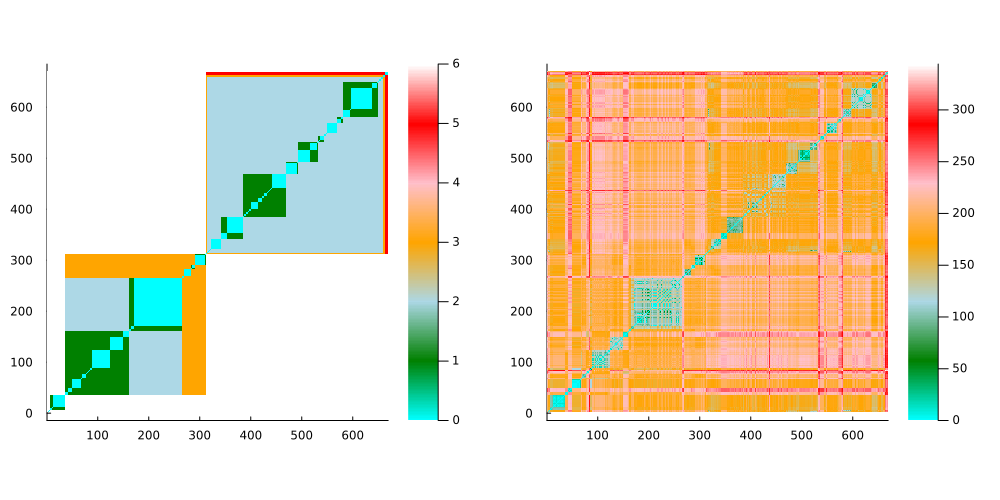

In [25]:
sh = heatmap(sqrt.(SPImtx[ncbileafidxs, ncbileafidxs] .* 10177), c=tcolors, ratio=1, size=(500,500))
# sh = heatmap(SPImtx[ncbileafidxs, ncbileafidxs], c=tcolors, ratio=1, size=(500,500))
th = heatmap(taxanomicdistance[ncbileafidxs, ncbileafidxs], c=tcolors, ratio=1, size=(500,500))
plot(th, sh, size=(1000,500), link=:y)

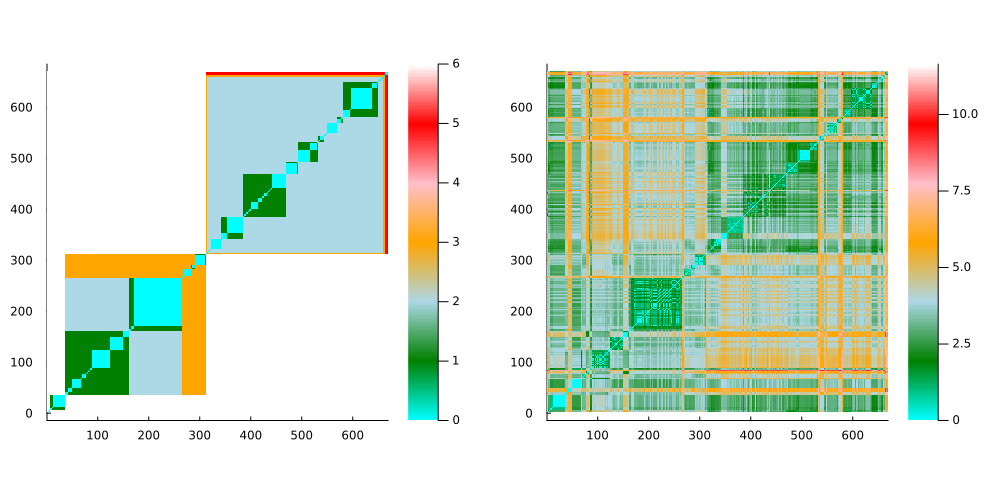

In [26]:
# sh = heatmap(sqrt.(SPImtx[ncbileafidxs, ncbileafidxs] .* 10177), c=tcolors, ratio=1, size=(500,500))
sh = heatmap(SPImtx[ncbileafidxs, ncbileafidxs], c=tcolors, ratio=1, size=(500,500))
th = heatmap(taxanomicdistance[ncbileafidxs, ncbileafidxs], c=tcolors, ratio=1, size=(500,500))
plot(th, sh, size=(1000,500), link=:y)

In [27]:
biobank.obs[biobank.obs.ID .== "MSK.19.36",:]

Row,ID,first_strain_id,strain_id,seq_id,donor_id,accession,phylum,class,order,family,genus,species,donor,phylum_ncbi,class_ncbi,order_ncbi,family_ncbi,genus_ncbi,species_ncbi,phylum_gtdb,class_gtdb,order_gtdb,family_gtdb,genus_gtdb,species_gtdb
,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String,String
1,MSK.19.36,MSK.19.36_Phocaeicola_dorei,MSK.19.36,TM532,FC0019,JAHOGS000000000,Bacteroidetes,Bacteroidia,Bacteroidales,Bacteroidaceae,Phocaeicola,Phocaeicola dorei,MSK.19,Bacteroidetes,Bacteroidia,Bacteroidales,Bacteroidaceae,Phocaeicola,Phocaeicola dorei,Bacteroidota,Bacteroidia,Bacteroidales,Bacteroidaceae,Phocaeicola,Phocaeicola dorei


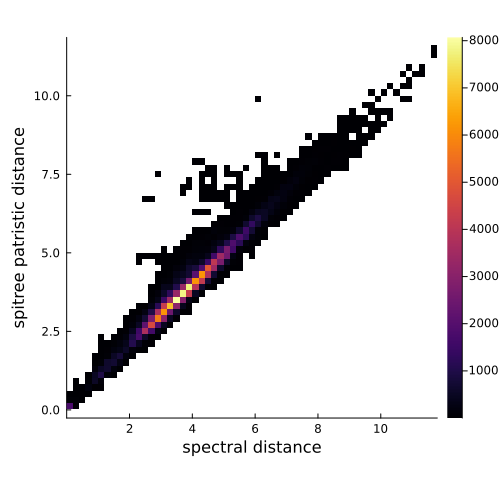

In [28]:
histogram2d(Dij[uppertriangle], spiDij[uppertriangle], 
    ratio=1, size=(500, 500),
    xlabel="spectral distance",
    ylabel="spitree patristic distance",
)

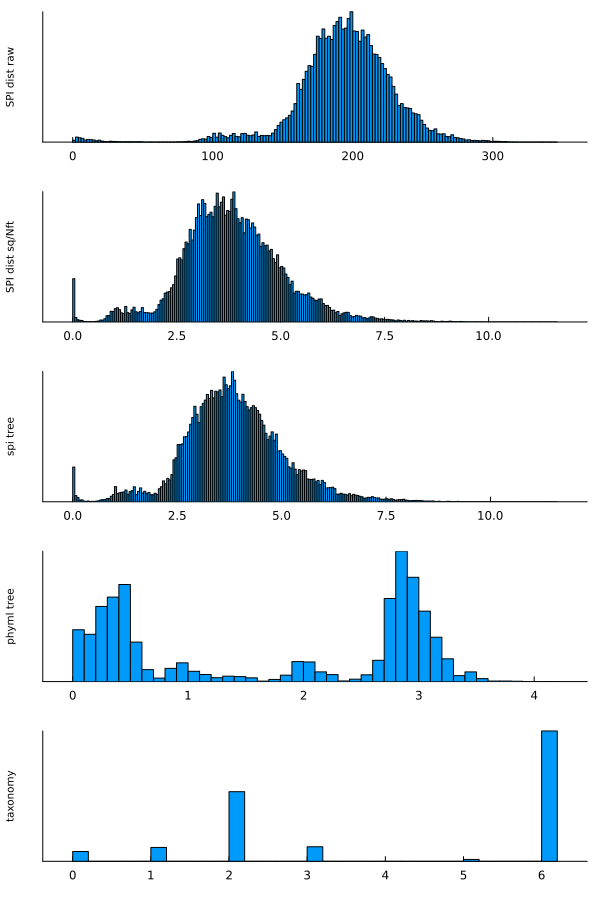

In [29]:
plot(
    histogram(sqrt.(Dij[uppertriangle].*10177), ylabel="SPI dist raw"),
    histogram(Dij[uppertriangle], ylabel="SPI dist sq/Nft"),
    histogram(spiDij[uppertriangle], ylabel="spi tree"),
    histogram(Pij[uppertriangle], ylabel="phyml tree"),
    histogram(Tij[uppertriangle], ylabel="taxonomy"),
    layout=grid(5,1),
    yticks=:none,
    ylabelfontsize=7,
    size=(600, 900),
    leftmargin=5Plots.mm,
)


## bac120 tree

In [62]:
# bbtaxa = biobank.obs[:,[:phylum_gtdb, :class_gtdb, :order_gtdb, :family_gtdb, :genus_gtdb, :species_gtdb]];
bbtaxa = biobank.obs[:,[:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]];
taxanomicdistance = pairwise(eachrow(Matrix(bbtaxa)[:,6:-1:1])) do a, b
    x = findfirst(a .== replace(b, "<unclassified>"=>"missing"))
    x === nothing ? 6 : x-1
end;

In [48]:
treebac120 = readnw(readline(projectdir("_research","BB669_bac120_phyml","BB669_bac120.phy-supporttree.txt")))
as_polytomy!(n->NewickTree.support(n)<0.5, treebac120)
ladderize!(treebac120)
leafnames_bac120 = getleafnames(treebac120); # same order as returned by patristic_distances
# order_treebac120 = filter(!isnothing, indexin(biobank.obs.ID, leafnames_bac120));
order_treebac120 = indexin(leafnames_bac120, biobank.obs.ID);

spitree = readnw(readline(datadir("exp_pro","BB669","BB669_inferred_spitree_nj.nw")))
as_polytomy!(n->NewickTree.support(n)<0.5, spitree)
ladderize!(spitree)
leafnames_spitree = getleafnames(spitree); # same order as returned by patristic_distances
# order_spi_treebac120 = filter(!isnothing, indexin(leafnames_spitree, leafnames_bac120));
order_spi_treebac120 = indexin(leafnames_bac120, leafnames_spitree);

Pij = p_distances(treebac120);
# Dij = sqrt.(SPImtx .* 10177)[order_treebac120, order_treebac120];
Dij = SPImtx[order_treebac120, order_treebac120];
spiDij = p_distances(spitree)[order_spi_treebac120, order_spi_treebac120];
Tij = taxanomicdistance[order_treebac120, order_treebac120];
uppertriangle = triu(trues(size(Pij)), 1);

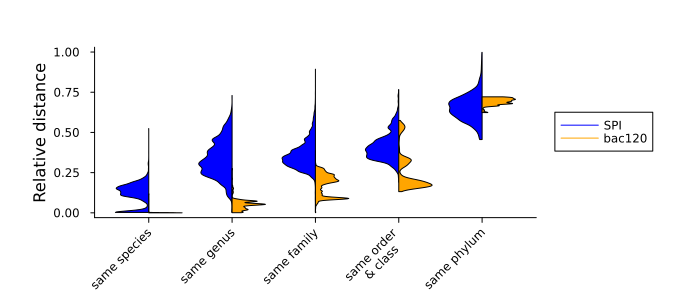

In [49]:
skipidxs = Not(5, 7)
# skipidxs = Not(6, 7)
labels = ["same species", "same genus", "same family", "same order\n & class", "same class ", "same phylum", "same kingdom"];
plot(size=(700,300), 
    # title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:(length(labels[skipidxs])), labels[skipidxs]),
    xlims=(.5, length(labels[skipidxs]) +.5),
    ylims=(0,1), widen=true,
    xrotation=45,
    legend=:outerright,
    # legendcolumns=2,
    grid=false,
)
xdata = Tij[uppertriangle]
ydata1 = (spiDij ./ maximum(spiDij))[uppertriangle]
ydata2 = (Pij ./ maximum(Pij))[uppertriangle]
# ydata2 = (spiDij ./ maximum(spiDij))[uppertriangle]
# ydata1 = (Dij)[uppertriangle]
# ydata2 = (Pij)[uppertriangle]
for (x, i) in enumerate(collect(0:6)[skipidxs])
    mask = xdata .== i
    violin!([x], ydata1[mask],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        )
    violin!([x], ydata2[mask],
        label="",
        c=:orange, 
        side=:right,
        trim=true
        )
end
plot!([0 0], c=[:blue :orange], label=["SPI" "bac120"])
# allspeciesdists = ydata1[xdata.==0]
# allspeciesdists2 = ydata2[xdata.==0]
# scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="", shape=:diamond)
# hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ", linestyle=:dash)
# annotate!(1:6, ones(6), ["n.s.", "***", "***", "***", "", "***"], fontsize=5)
plot!()

In [50]:
savefig(joinpath(pdir, "SPIdistUPvsbac120patdist_splitbyNCBItaxonomy_groupedviolin.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/SPIdistUPvsbac120patdist_splitbyNCBItaxonomy_groupedviolin.pdf"

## conflated pairs violin plots (GTDB)

In [55]:
# bbtaxa = biobank.obs[:,[:phylum_ncbi, :class_ncbi, :order_ncbi, :family_ncbi, :genus_ncbi, :species_ncbi]];
bbtaxa = biobank.obs[:,[:phylum_gtdb, :class_gtdb, :order_gtdb, :family_gtdb, :genus_gtdb, :species_gtdb]];

In [56]:
# 4 Main metabolites  ["Acetate_mM", "Butyrate_mM", "Propionate_mM", "Succinate_mM"]
# metabolitedistance = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, 1:4]');
# metabolitedistancerel = Distances.pairwise(Euclidean(), biobank["metabolites_foldchange"].X[:, :]');
# metabolitedistance_mM = Distances.pairwise(Euclidean(), biobank["metabolites_millimolar"].X[:, :]');

taxanomicdistance = pairwise(eachrow(Matrix(bbtaxa)[:,6:-1:1])) do a, b
    x = findfirst(a .== replace(b, "<unclassified>"=>"missing"))
    x === nothing ? 6 : x-1
end;

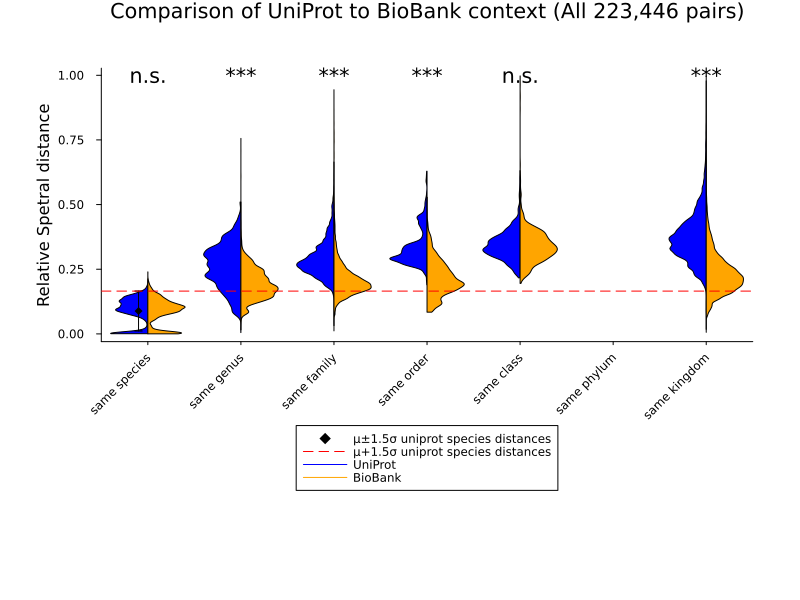

In [63]:
n = 7
labels = ["same species", "same genus", "same family", "same order", "same class", "same phylum", "same kingdom"];
plot(size=(800,600), 
    title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative Spetral distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:n, labels[1:n]),
    xlims=(.5, n +.5),
    xrotation=45,
    legend=:outerbottom,
    grid=false,
)
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in 0:n
    mask = xdata .== i
    violin!(xdata[mask].+1, ydata1[mask],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        )
    violin!(xdata[mask].+1, ydata2[mask],
        label="",
        c=:orange, 
        side=:right,
        trim=true
        )
end
allspeciesdists = ydata1[xdata.==0]
allspeciesdists2 = ydata2[xdata.==0]
scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="μ±1.5σ uniprot species distances", shape=:diamond)
# scatter!([1.1], [mean(allspeciesdists2)], yerror=1.5std(allspeciesdists2), c=:black,  shape=:diamond)
# hline!([mean(allspeciesdists)+std(allspeciesdists)], c=:red, linestyle=:dash)
hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ uniprot species distances", linestyle=:dash)
# hline!([mean(allspeciesdists2)+1.5std(allspeciesdists2)], c=:orange, linestyle=:dash)
plot!([0 0], c=[:blue :orange], label=["UniProt" "BioBank"])
annotate!(1:7, ones(6), ["n.s.", "***", "***", "***", "n.s.", "", "***"], fontsize=5)
plot!()

In [64]:
savefig(joinpath(pdir, "SPIdistUPvsSPIdistBB_splitbyGTDBtaxonomy_groupedviolin.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/BB669distanceplots_taxonomy/SPIdistUPvsSPIdistBB_splitbyGTDBtaxonomy_groupedviolin.pdf"

## KS and wilcoxon test of each distribution

In [65]:
using HypothesisTests

In [66]:
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in 0:n
    mask = xdata .== i
    pval = pvalue(ApproximateTwoSampleKSTest(ydata1[mask], ydata2[mask]))
    @show (i, pval * 7)
end

(i, pval * 7) = (0, 4.701623595193567e-26)
(i, pval * 7) = (1, 0.0)
(i, pval * 7) = (2, 0.0)
(i, pval * 7) = (3, 0.0)
(i, pval * 7) = (4, 0.07709846220847276)
(i, pval * 7) = (5, NaN)
(i, pval * 7) = (6, 0.0)
(i, pval * 7) = (7, NaN)


In [68]:
xdata = taxanomicdistance[uppertriangle]
ydata1 = (SPImtx ./ maximum(SPImtx))[uppertriangle]
ydata2 = (BBSPImtx ./ maximum(BBSPImtx))[uppertriangle]
for i in [0, 1, 2, 3, 4, 6]
    mask = xdata .== i
    pval = pvalue(MannWhitneyUTest(ydata1[mask], ydata2[mask]); tail=:right)
    @show (i, pval * 7)
end

(i, pval * 7) = (0, 0.08722134167891941)
(i, pval * 7) = (1, 0.0)
(i, pval * 7) = (2, 0.0)
(i, pval * 7) = (3, 0.0)
(i, pval * 7) = (4, 0.7915385027024147)
(i, pval * 7) = (6, 0.0)


## Conflated pairs

In [108]:
issameorder = taxanomicdistance .== 3

669×669 BitMatrix:
 0  0  0  0  0  0  0  0  0  0  0  0  0  …  0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0  …  0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     0  0  0  1  1  0  1  1  0  0  1  1
 ⋮              ⋮              ⋮        ⋱           ⋮              ⋮        
 1  1  1  1  1  1  1  1  1  1  1  1  1  …  0  0  1  0  0  1  0  1  1  1  0  1
 1  1  1  1  1  1  1  1  1  1  1  1  1     0  

In [109]:
speciesthreshold = mean(allspeciesdists)+1.5std(allspeciesdists)

0.17103652327378055

In [110]:
BBUPisbelowthreshold = SPImtx .< speciesthreshold;
any(issameorder .& BBUPisbelowthreshold)

false

In [111]:
BBisbelowthreshold = BBSPImtx .< speciesthreshold
any(issameorder .& BBisbelowthreshold)

true

In [132]:
incorrecttaxa = union(getindex.(findall(issameorder .& BBisbelowthreshold), 1), getindex.(findall(issameorder .& BBisbelowthreshold), 2))
orderedincorrecttaxa = incorrecttaxa[sortperm(bbtaxa[incorrecttaxa, :].family_ncbi)]

258-element Vector{Int64}:
   1
   4
   5
   6
   8
  14
 134
 135
 136
 137
   ⋮
 398
 399
 401
 402
 403
 404
 425
 427
 429

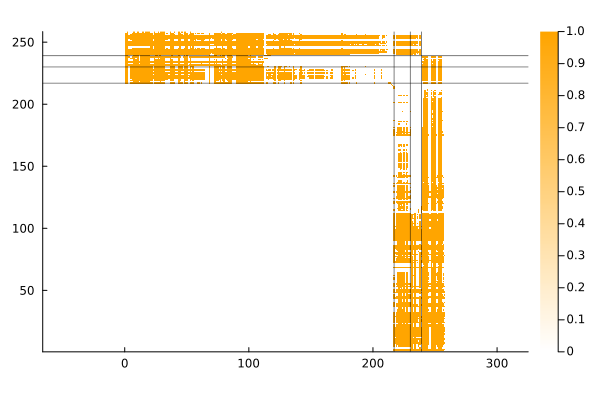

In [149]:
pltmtx = float.((issameorder .& BBisbelowthreshold)[orderedincorrecttaxa, orderedincorrecttaxa])
pltmtx[pltmtx .== 0] .= NaN
heatmap(pltmtx, c=[:white, :orange], ratio=1)
vline!([217, 230, 239], c=:black, lw=.5)
hline!([217, 230, 239], c=:black, lw=.5)

In [150]:
savefig(joinpath(pdir, "incorrecttaxa_heatmap.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/BB669distanceplots_taxonomy/incorrecttaxa_heatmap.pdf"

In [114]:
bbtaxa[incorrecttaxa, :]

Row,phylum_ncbi,class_ncbi,order_ncbi,family_ncbi,genus_ncbi,species_ncbi
,String,String,String,String,String,String
1,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes onderdonkii
2,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes onderdonkii
3,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes finegoldii
4,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes onderdonkii
5,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes finegoldii
6,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes finegoldii
7,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes onderdonkii
8,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes onderdonkii
9,Bacteroidetes,Bacteroidia,Bacteroidales,Rikenellaceae,Alistipes,Alistipes putredinis


In [130]:
sort(countmap(bbtaxa[incorrecttaxa, :].family_ncbi), byvalue=false, rev=false)

OrderedCollections.OrderedDict{String, Int64} with 6 entries:
  "Bacteroidaceae"   => 214
  "Lachnospiraceae"  => 1
  "Oscillospiraceae" => 1
  "Prevotellaceae"   => 14
  "Rikenellaceae"    => 9
  "Tannerellaceae"   => 19

In [140]:
214 + 14

228

In [ ]:
sort(bbtaxa[incorrecttaxa, :].family_ncbi

In [131]:
orderedincorrecttaxa = incorrecttaxa[sortperm(bbtaxa[incorrecttaxa, :].family_ncbi)]

258-element Vector{Int64}:
   1
   4
   5
   6
   8
  14
 134
 135
 136
 137
   ⋮
 398
 399
 401
 402
 403
 404
 425
 427
 429

In [128]:
biobank.obs.donor_id |> unique

27-element Vector{String}:
 "FC0016"
 "FC0010"
 "FC0013"
 "FC0018"
 "FC0014"
 "FC0009"
 "FC0015"
 "FC0006"
 "FC0017"
 "FC0019"
 ⋮
 "DFI0001"
 "DFI0004"
 "FC0007"
 "FC0002"
 "DFI0005"
 "DFI0003"
 "DFI0006"
 "DFI0002"
 "FC0008"

## Better plots

In [11]:
treebac120 = readnw(readline(projectdir("_research","BB669_bac120_phyml","BB669_bac120.phy-supporttree.txt")))
as_polytomy!(n->NewickTree.support(n)<0.5, treebac120)
ladderize!(treebac120)
leafnames_bac120 = getleafnames(treebac120); # same order as returned by patristic_distances
# order_treebac120 = filter(!isnothing, indexin(biobank.obs.ID, leafnames_bac120));
order_treebac120 = indexin(leafnames_bac120, biobank.obs.ID);

In [12]:
tree16s = readnw(readline(projectdir("_research","BB669_16S_phyml","BB669_16S.phy-supporttree.txt")))
as_polytomy!(n->NewickTree.support(n)<0.5, tree16s)
ladderize!(tree16s)
leafnames_16S = getleafnames(tree16s); # same order as returned by patristic_distances
# order_tree16s = filter(!isnothing, indexin(biobank.obs.ID, leafnames_16S));
order_tree16S = indexin(leafnames_16S, biobank.obs.ID);

In [13]:
spitree = readnw(readline(datadir("exp_pro","BB669","BB669_inferred_spitree_nj.nw")))
# spitree = readnw(readline(datadir("exp_pro","BB669","BB669_inferred_spitree_nj_outgrouped.nw")))
as_polytomy!(n->NewickTree.support(n)<0.5, spitree)
ladderize!(spitree)
leafnames_spitree = getleafnames(spitree); # same order as returned by patristic_distances
order_treespitree = indexin(leafnames_spitree, biobank.obs.ID);
# order_spi_treebac120 = filter(!isnothing, indexin(leafnames_spitree, leafnames_bac120));
order_spi_treebac120 = indexin(leafnames_bac120, leafnames_spitree);
order_spi_tree16s = indexin(leafnames_16S, leafnames_spitree);

In [17]:
sixPij = p_distances(tree16s)
bacPij = p_distances(treebac120);
spiPij = p_distances(spitree);
# Dij = sqrt.(SPImtx .* 10177)[order_treebac120, order_treebac120];
# Dij = SPImtx[order_treebac120, order_treebac120];
sixTij = taxanomicdistance[order_tree16S, order_tree16S];
bacTij = taxanomicdistance[order_treebac120, order_treebac120];
spiTij = taxanomicdistance[order_treespitree, order_treespitree];

uppertriangle_six = triu(trues(size(sixPij)), 1);
uppertriangle_bac = triu(trues(size(bacPij)), 1);
uppertriangle_spi = triu(trues(size(spiPij)), 1);

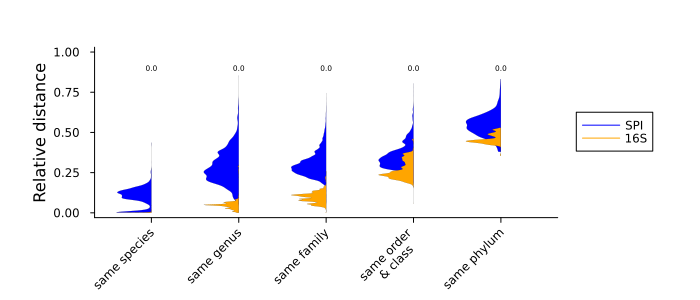

In [32]:
skipidxs = Not(5, 7)
labels = ["same species", "same genus", "same family", "same order\n & class", "same class ", "same phylum", "same kingdom"];
plot(size=(700,300), 
    # title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:(length(labels[skipidxs])), labels[skipidxs]),
    xlims=(.5, length(labels[skipidxs]) +.5),
    xrotation=45,
    ylims=(0,1), widen=true,
    legend=:outerright,
    # legendcolumns=2,
    grid=false,
)
xdata1 = spiTij[uppertriangle_spi]
xdata2 = sixTij[uppertriangle_six]
ydata1 = (spiPij ./ maximum(spiPij))[uppertriangle_spi]
ydata2 = (sixPij ./ maximum(sixPij))[uppertriangle_six]
# ydata2 = (spiDij ./ maximum(spiDij))[uppertriangle]
# ydata1 = (Dij)[uppertriangle]
# ydata2 = (Pij)[uppertriangle]
for (x, i) in enumerate(collect(0:6)[skipidxs])
    mask1 = xdata1 .== i
    mask2 = xdata2 .== i
    violin!([x], ydata1[mask1],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        lw=0.1,linecolor=:black,
        )
    violin!([x], ydata2[mask2],
        label="",
        c=:orange, 
        side=:left,
        trim=true,
        lw=0.1, linecolor=:black,
        )
    pval = pvalue(TTest(ydata1[mask1], ydata2[mask2]); tail=:both)
    annotate!([x], [.9], text(string(pval), 5))
end
plot!([0 0], c=[:blue :orange], label=["SPI" "16S"])
# allspeciesdists = ydata1[xdata.==0]
# allspeciesdists2 = ydata2[xdata.==0]
# scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="", shape=:diamond)
# hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ", linestyle=:dash)
# annotate!(1:6, ones(6), ["n.s.", "***", "***", "***", "", "***"], fontsize=5)
plot!()

In [33]:
savefig(joinpath(pdir, "SPIdistUPvs16Spatdist_splitbyNCBItaxonomy_groupedviolin.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/SPIdistUPvs16Spatdist_splitbyNCBItaxonomy_groupedviolin.pdf"

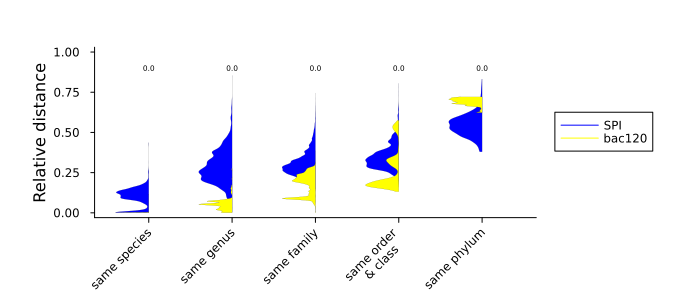

In [34]:
skipidxs = Not(5, 7)
labels = ["same species", "same genus", "same family", "same order\n & class", "same class ", "same phylum", "same kingdom"];
plot(size=(700,300), 
    # title="Comparison of UniProt to BioBank context (All 223,446 pairs)", 
    ylabel="Relative distance", 
    tickdirection=:out,
    # format=:png, dpi=200,
    margin=10Plots.Measures.mm,
    xticks=(1:(length(labels[skipidxs])), labels[skipidxs]),
    xlims=(.5, length(labels[skipidxs]) +.5),
    xrotation=45,
    ylims=(0,1), widen=true,
    legend=:outerright,
    # legendcolumns=2,
    grid=false,
)
xdata1 = spiTij[uppertriangle_spi]
xdata2 = bacTij[uppertriangle_bac]
ydata1 = (spiPij ./ maximum(spiPij))[uppertriangle_spi]
ydata2 = (bacPij ./ maximum(bacPij))[uppertriangle_bac]
# ydata2 = (spiDij ./ maximum(spiDij))[uppertriangle]
# ydata1 = (Dij)[uppertriangle]
# ydata2 = (Pij)[uppertriangle]
for (x, i) in enumerate(collect(0:6)[skipidxs])
    mask1 = xdata1 .== i
    mask2 = xdata2 .== i
    violin!([x], ydata1[mask1],
        label="",
        c=:blue, 
        side=:left,
        trim=true,
        # alpha=.5,
        lw=0.1, linecolor=:black,
        )
    violin!([x], ydata2[mask2],
        label="",
        c=:yellow, 
        side=:left,
        trim=true,
        # alpha=.5,
        lw=0.1, linecolor=:black,
        )
    pval = pvalue(MannWhitneyUTest(ydata1[mask1], ydata2[mask2]); tail=:both)
    annotate!([x], [.9], text(string(pval), 5))
end
plot!([0 0], c=[:blue :yellow], label=["SPI" "bac120"])
# allspeciesdists = ydata1[xdata.==0]
# allspeciesdists2 = ydata2[xdata.==0]
# scatter!([.9], [mean(allspeciesdists)], yerror=1.5std(allspeciesdists), c=:black, label="", shape=:diamond)
# hline!([mean(allspeciesdists)+1.5std(allspeciesdists)], c=:red, label="μ+1.5σ", linestyle=:dash)
# annotate!(1:6, ones(6), ["n.s.", "***", "***", "***", "", "***"], fontsize=5)
plot!()

In [35]:
savefig(joinpath(pdir, "SPIdistUPvsbac120patdist_splitbyNCBItaxonomy_groupedviolin.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/SPIdistUPvsbac120patdist_splitbyNCBItaxonomy_groupedviolin.pdf"

In [153]:
xdata1 = spiTij[uppertriangle_spi]
ydata1 = (spiPij ./ maximum(spiPij))[uppertriangle_spi]
xdata2 = bacTij[uppertriangle_bac]
ydata2 = (bacPij ./ maximum(bacPij))[uppertriangle_bac]
xdata3 = sixTij[uppertriangle_six]
ydata3 = (sixPij ./ maximum(sixPij))[uppertriangle_six]


222778-element Vector{Float64}:
 4.8750157359414185e-9
 0.007727796944362563
 0.007727796944362563
 0.007727796944362563
 0.007727796944362563
 4.8750157359414185e-9
 0.008522948573512627
 0.008522948573512627
 0.0007951565041658009
 0.0007951565041658009
 ⋮
 0.000403019988398145
 0.000403019988398145
 0.000403019988398145
 0.000403019988398145
 0.000403019988398145
 0.000403019988398145
 0.000403019988398145
 4.8750157359414185e-9
 4.8750157359414185e-9

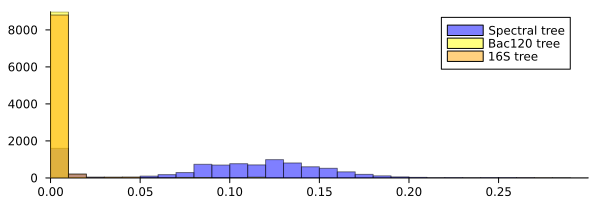

In [154]:
plot(xlims=(0,.3), size=(600,200), tickdir=:out)
histogram!(ydata1[xdata1.==0],nbins=50, c=:blue, alpha=.5, label="Spectral tree")
histogram!(ydata2[xdata2.==0],nbins=15, c=:yellow, alpha=.5, label="Bac120 tree")
histogram!(ydata3[xdata3.==0],nbins=50, c=:orange, alpha=.5, label="16S tree")

In [155]:
savefig(joinpath(pdir, "histogram_samespecies_dist.pdf"))

"/Users/bend/projects/Doran_etal_2022/plots/BB669distanceplots_16S_bac120_taxonomy/histogram_samespecies_dist.pdf"